# Mount St. Helens

This notebook creates figures with PyVista in collaboration with Kristen Marberry's thesis (citation below) exploring the hydrogeophysical conditions of the debris blockage at Spirit Lake under Mt. St. Helens.
This investigation's focus was to provide a geophysical interpretation of the subsurface, including locating the water table and a buried 1.8 $m$ diameter steel pipe installed for the emergency pumping of Spirit Lake in the early 1980s.
Ground-penetrating radar (GPR) and shallow seismic images were collected and are shown in a common georeferenced environment to gain insight into subsurface conditions, identify regions where the water table is perched, and locate the buried pumping pipe.

The GPR and seismic processing workflows for this investigation were performed in several separate software, making it challenging to collect the results into a single environment for co-interpretation. The PyVista framework provides tooling to collect the processed data from those fragmented workflows, bringing all of the data together. PyVista enabled us to gain insight into the 3D relationships and variability of all of the project data by showing the GPR and seismic images next to each other in 3D with a high-resolution surface DEM whereas only 2D analysis was previously available.


> Kristen Marberry. *Subsurface characterization and liquefaction potential assessment of the spirit lake debris blockage at Mount St. Helens, Washington using multi-method geophysics*, 2020.




In [1]:
import pyvista as pv
import numpy as np
from glob import glob
import matplotlib.pyplot as plt

In [2]:
pv.set_plot_theme("document")
pv.rcParams["colorbar_horizontal"]["width"] = 0.3
pv.rcParams["colorbar_horizontal"]["position_x"] = 0.6
pv.rcParams["font"]["family"] = "times"
fs = 28

Load all of the data from the archive as a single `pyvista.MultiBlock` dataset that we can easily access.

In [3]:
# Load all data
data = pv.read("data/MSH.vtm")
data

MultiBlock (0x7fa581a410a8)
  N Blocks:	6
  X Bounds:	1185669.635, 1239874.823
  Y Bounds:	313411.561, 372466.801
  Z Bounds:	2008.470, 8257.164

In [4]:
roi = pv.Box(data["Terrain Local"].bounds).outline()

In [5]:
# Common display arguments
sargs = dict(title_font_size=18, label_font_size=18, n_labels=3)

dargs_gpr = dict(scalars='gpr-data', 
                 cmap='binary',
                 lighting=False,
                 stitle="Amplitude",
                 clim=[-2.0,2.0], scalar_bar_args=sargs)

dargs_topo = dict(opacity=0.5, cmap="gist_earth", 
                  clim=[3200*0.3048,3800*0.3048], show_scalar_bar=False,
                  pickable=False, scalars="lidar-meters", stitle="Elevation (m)")

dargs_vel = dict(cmap="rainbow", scalars="Velocity(m/s)",
                 scalar_bar_args=sargs, )

## Create Figures

First is an overview of the project site.

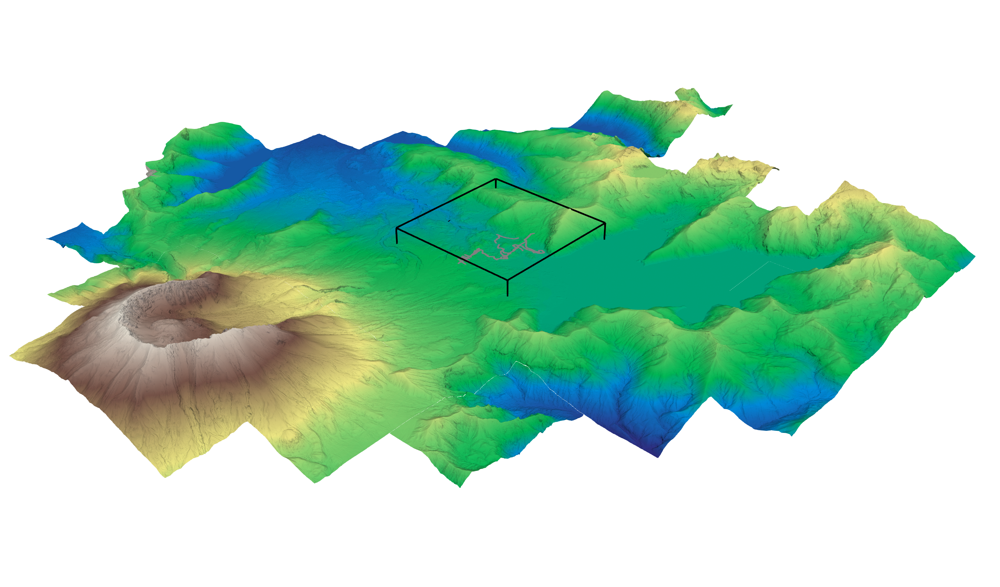

In [6]:
# MSH Overview
p = pv.Plotter(notebook=1, window_size=np.array([1024, 768]*3))
p.enable_depth_peeling(5, 0)
p.enable_anti_aliasing()

p.add_mesh(data["GPR Paths"], color="grey")
p.add_mesh(data["Terrain Whole"], cmap="terrain",
           show_scalar_bar=False)#**dargs_topo)
p.add_mesh(roi, color="k", line_width=5)


p.window_size = 2974, 1748
p.camera_position= [(1258113.6584761892, 294991.3315049712, 40106.91378178596),
 (1217285.2228724286, 340558.1292802905, 1281.518902676089),
 (-0.3589898448635915, 0.39776415167864426, 0.8443399617003706)]

p.show()

> The research site area adjacent to Mt. St. Helens and the adjacent lake.

In [7]:
s1_refrac = data["Refraction Images"]["Refraction: Line 1"]
s2_refrac = data["Refraction Images"]["Refraction: Line 2"]
lines = ["P2_5aSP", "P2_5SP"]

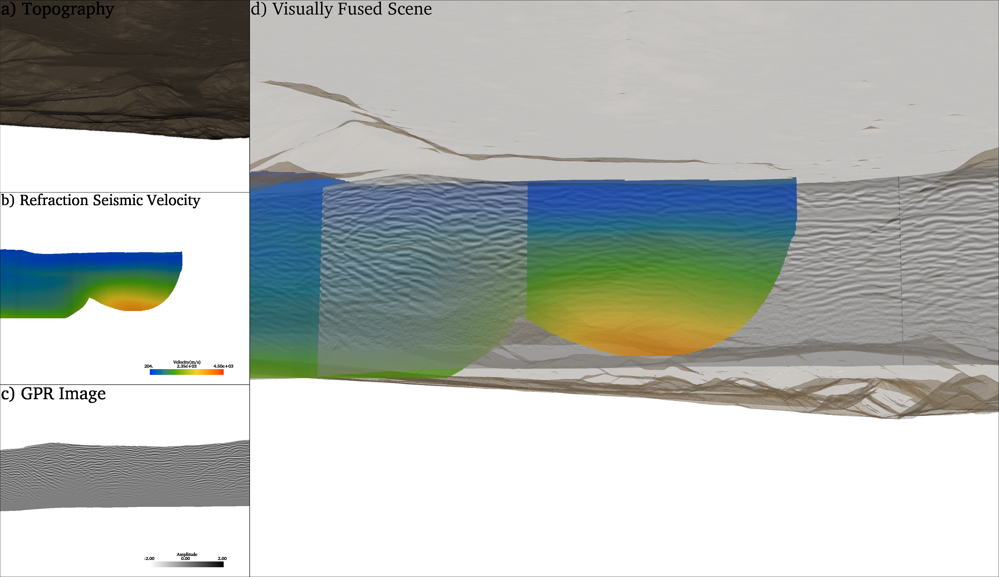

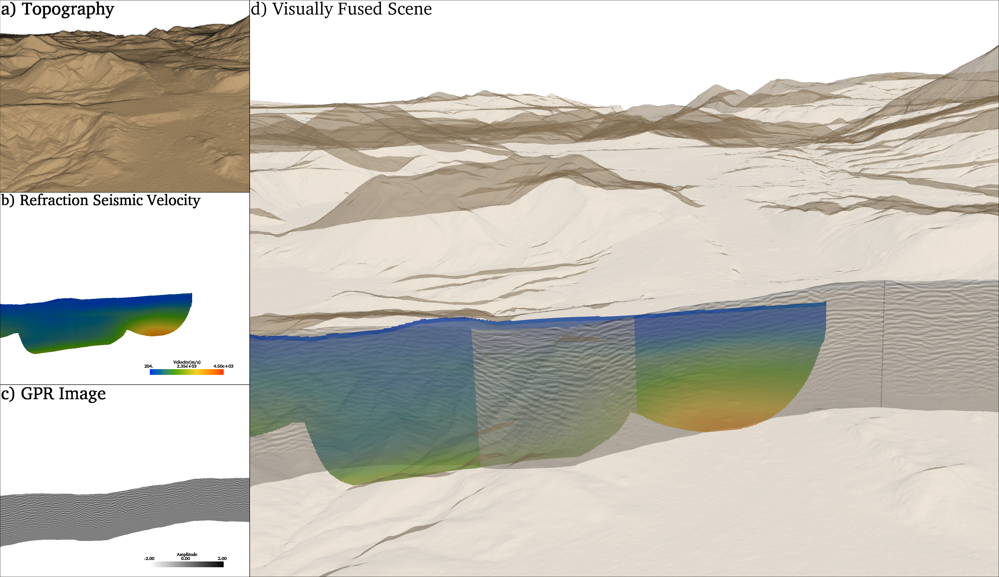

In [8]:
dargs_gpr["cmap"] = "binary"

# make a fused scene
p = pv.Plotter(notebook=1, shape="3|1", window_size=np.array([int(1024*1.3), 768])*3)

# Left views
p.subplot(0)
dargs_topo["opacity"] = 1.0
p.add_mesh(data["Terrain Local"], color="tan", opacity=1.0)#**dargs_topo)
p.enable_eye_dome_lighting()
p.add_text("a) Topography", font_size=fs)

p.subplot(1)
p.add_mesh(s2_refrac.threshold(), opacity=1.0, **dargs_vel)
p.add_text("b) Refraction Seismic Velocity", font_size=fs)

p.subplot(2)
p.add_mesh(data["GPR Images"][lines].combine().threshold(0.5, scalars="mask"), 
           opacity=1.0, **dargs_gpr)
p.add_text("c) GPR Image", font_size=fs)



#### This is the "fused" scenee
p.subplot(3)
p.add_text("d) Visually Fused Scene", font_size=fs)
p.enable_depth_peeling(5, 0)
p.enable_anti_aliasing()


dargs_topo["opacity"] = 0.5
p.add_mesh(data["Terrain Local"], color="tan", opacity=0.3)#**dargs_topo)

# p.add_mesh(s1_refrac.threshold(), **dargs_vel)
p.add_mesh(s2_refrac.threshold(), opacity=0.75, **dargs_vel)


p.add_mesh(data["GPR Images"][lines].combine().threshold(0.5, scalars="mask"), 
           opacity=0.6, **dargs_gpr)


p.link_views()


# Bottom view
p.camera_position = [(1217528.7937978972, 343302.26147555956, 3292.55521477183),
 (1216038.5381614524, 342869.0618040603, 3447.0644607682334),
 (0.09519248631159238, 0.027442326570412373, 0.9950805541574111)]

p.show(auto_close=False)

# Top View
p.camera_position = [(1217864.359113541, 342976.4777451726, 3812.745544071257),
 (1215182.808876933, 342914.3461122701, 3149.9246634037854),
 (-0.24045096415763886, 0.026502151018133482, 0.9702994227696284)]

p.show()

> A section of the seismic and GPR images where a perched water table is possibly present beneath the debris blockage. The seismic refraction velocity analysis shows a region around 1500 $m/s$ adjacent to where the GPR images show coherent horizontal reflectors, possibly indicating the presence of a perched water table.

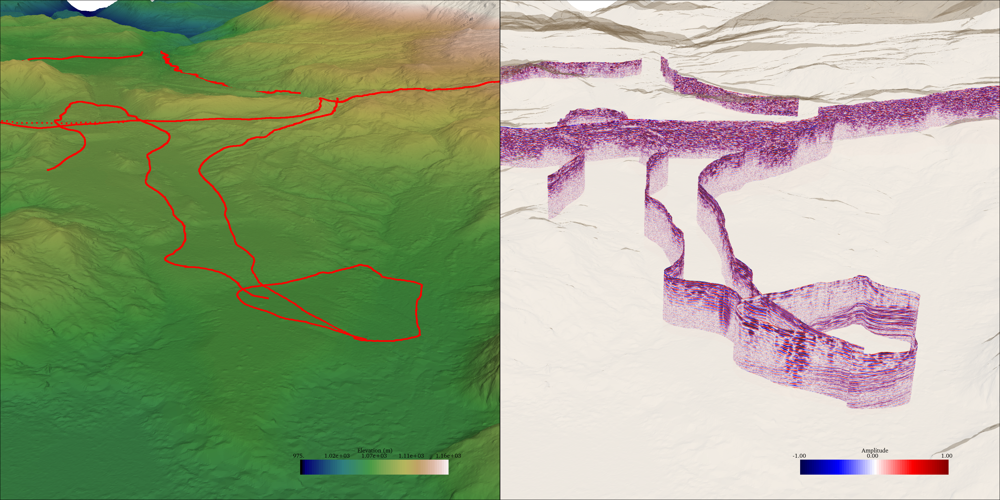

In [9]:
p = pv.Plotter(notebook=1, shape=(1,2),
               window_size=np.array([int(1024*1.5), 768])*2)

dargs_topo["opacity"] = 1.0
dargs_topo["show_scalar_bar"] = True
p.add_mesh(data["Terrain Local"], **dargs_topo)
dargs_topo["show_scalar_bar"] = False

paths = data["GPR Paths"].copy()
paths.points[:,-1] += 10.0

p.add_mesh(paths, color="red")
# p.enable_eye_dome_lighting()


p.subplot(0,1)
p.enable_depth_peeling(5, 0)
p.enable_anti_aliasing()

dargs_topo["opacity"] = 0.25
p.add_mesh(data["Terrain Local"], color=True, opacity=0.2)

dargs_gpr["clim"] = [-1,1]
dargs_gpr["cmap"] = "seismic"
p.add_mesh(data["GPR Images"].combine().threshold(0.5, scalars="mask"), **dargs_gpr)


p.link_views()
p.camera_position = [(1220108.6296860871, 343073.3833504073, 4311.3702928339435),
 (1216383.7185870584, 343745.80251143046, 2884.1912703567564),
 (-0.35757285806524114, 0.0013280050340058192, 0.9338843009590027)]

p.show()

> A section of the GPR images near where the emergency pumping pipe is proposed to be located, and two coherent reflections are visible in line with the proposed path.